In [1]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
import cv2
from sklearn.cluster import KMeans
from sklearn.preprocessing import MinMaxScaler
from skimage.segmentation import slic, mark_boundaries
from skimage.util import img_as_float 
from skimage.measure import label
from scipy.ndimage import binary_fill_holes, binary_dilation, gaussian_filter, distance_transform_edt
from skimage import exposure
from scipy.spatial import distance
from skimage.draw import line
from skimage.color import gray2rgb
from tqdm import tqdm

In [2]:
data = np.load("/kaggle/input/lung-cancer/Mohammad_Preprocessing/Mohammad_Preprocessing/train_set.npz")
full_slices = data['full_slices']

(512, 512, 3)


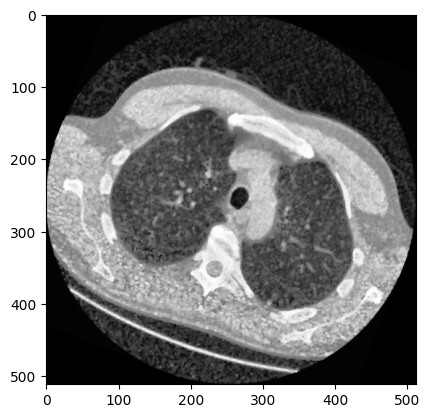

In [3]:
image = full_slices[10]
# if len(image.shape) > 2: image = image[:,:,0]

print(image.shape)
plt.imshow(image, cmap='gray')
plt.show()

In [4]:
def apply_slic(image): 
    # loop over the number of segments
    for numSegments in (5, 10, 50):
    	# apply SLIC and extract (approximately) the supplied number
    	# of segments
    	segments = slic(image, n_segments = numSegments, sigma = 5)
    	# show the output of SLIC
    	fig = plt.figure("Superpixels -- %d segments" % (numSegments))
    	ax = fig.add_subplot(1, 3, 1)
    	ax.imshow(mark_boundaries(image, segments))
    	plt.axis("off")
    # show the plots
    plt.show()

In [5]:
# for image in full_slices[:10]:
#     apply_slic(image)

## Intensity-based KMeans segmentation
Xu, M., Qi, S., Yue, Y. et al. Segmentation of lung parenchyma in CT images using CNN trained with the clustering algorithm generated dataset. BioMed Eng OnLine 18, 2 (2019). https://doi.org/10.1186/s12938-018-0619-9

In [6]:
def cross_verification(intensity_map):
    # Initialize mask with zeros
    mask = np.zeros_like(intensity_map, dtype=int)
    
    rows, cols = intensity_map.shape
    
    for i in range(rows):
        for j in range(cols):
            # Skip high-intensity pixels
            if intensity_map[i, j] > 0:
                continue
            
            # Check if at least one high-intensity pixel exists in each direction
            left = any(intensity_map[i, :j] > 0)
            right = any(intensity_map[i, j + 1:] > 0)
            up = any(intensity_map[:i, j] > 0)
            down = any(intensity_map[i + 1:, j] > 0)
            
            # If all checks pass, mark the pixel
            if left and right and up and down:
                mask[i, j] = 1
    
    return mask

In [7]:
def check_clustering(intensity_map): 
    total = intensity_map[0,0] + intensity_map[0,-1] + intensity_map[-1, 0] + intensity_map[-1, -1]
    return total < 3 # if total > 2, this means that the clustering is flipped

In [8]:
sr = cv2.dnn_superres.DnnSuperResImpl_create()
path = "/kaggle/input/fsrcnn/other/default/1/FSRCNN_x3.pb"
sr.readModel(path)
sr.setModel("fsrcnn",3)

In [15]:
def segment_lung_parenchyma(image, patch_size=8, expand_by=0, min_connected=30, blur_image=None, debug=False):
    # original = image
    # image = exposure.equalize_hist(image)
    # plt.figure(dpi=300)

    # plt.subplot(1, 2, 1) 
    # plt.title('Original Image')
    # plt.imshow(original, cmap='gray')
    # plt.axis('off')
    # plt.subplot(1, 2, 2) 
    # plt.title('Equalized Image')
    # plt.imshow(image, cmap='gray')
    # plt.axis('off')

    # Blur the image to improve clustering stability 
    # if blur_image is not None: 
    #     image = gaussian_filter(image, sigma=blur_image)

    original_shape = np.array(image.shape)
    # print(original_shape)
    # image = sr.upsample(image)
    # plt.imshow(image, cmap='gray')
    
    rows = cols = image.shape[0] // patch_size
    patches = image.reshape(rows, patch_size, -1, patch_size)
    patches = patches.swapaxes(1, 2).reshape(-1, patch_size ** 2)

    mean_intensity = patches.mean(axis=-1).reshape(-1, 1)
    min_intensity = patches.min(axis=-1).reshape(-1, 1)
    
    if debug:
        print(f'Mean: {mean_intensity.shape}')
        print(f'Min: {min_intensity.shape}')
        mean_img = mean_intensity.reshape(rows, cols)
        min_img = min_intensity.reshape(rows, cols)

        fig, axs = plt.subplots(1, 2)
        axs[0].imshow(mean_img, cmap='gray')
        axs[1].imshow(min_img, cmap='gray')
        plt.tight_layout()
        plt.show()

    while True: 
        kmeans_mean = KMeans(n_clusters=2, n_init=10).fit(mean_intensity)
        kmeans_mean_intensity_map = kmeans_mean.labels_.reshape(rows, cols)
        if check_clustering(kmeans_mean_intensity_map): break 

    while True: 
        kmeans_min = KMeans(n_clusters=2, n_init=10).fit(min_intensity)
        kmeans_min_intensity_map = kmeans_min.labels_.reshape(rows, cols)
        if check_clustering(kmeans_min_intensity_map): break 
    
    if debug:
        fig, axs = plt.subplots(1, 2)
        axs[0].imshow(kmeans_mean_intensity_map, cmap='gray')
        axs[1].imshow(kmeans_min_intensity_map, cmap='gray')
        plt.tight_layout()
        plt.show()

    mask_mean = cross_verification(kmeans_mean_intensity_map)
    mask_min = cross_verification(kmeans_min_intensity_map)

    threshold = 0.2
    mask_mean = gaussian_filter(mask_mean.astype(float), sigma=1)
    mask_mean = (mask_mean >= threshold).astype(int)

    mask_min = gaussian_filter(mask_min.astype(float), sigma=1)
    mask_min = (mask_min >= threshold).astype(int)
    
    if debug:
        fig, axs = plt.subplots(1, 2)
        axs[0].imshow(mask_mean, cmap='gray')
        axs[1].imshow(mask_min, cmap='gray')
        plt.tight_layout()
        plt.show()

    combined_mask = np.logical_and(mask_mean, mask_min)
    combined_mask = mask_mean

    if debug:
        plt.imshow(combined_mask, cmap='gray')
        plt.show()

    labeled_mask = label(combined_mask, connectivity=1)
    
    region_sizes = np.bincount(labeled_mask.flat)

    max_size = np.max(region_sizes)
    filtered_mask = np.isin(labeled_mask, np.where((region_sizes > min_connected) & (region_sizes < max_size)))
    combined_mask = filtered_mask.astype(int)
    
    # if debug:
    #     plt.imshow(labeled_mask, cmap='gray')
    #     plt.show()

    combined_mask = cv2.resize(combined_mask.astype(np.uint8) * 255, (original_shape[1], original_shape[0]))
    
    # kernel = np.ones((10,10), np.uint8)
    # combined_mask = cv2.morphologyEx(np.array(combined_mask, dtype=np.uint8), cv2.MORPH_CLOSE, kernel)

    if debug:
        plt.imshow(combined_mask, cmap='gray')
        plt.show()
    
    structuring_element = np.ones((expand_by + 1, expand_by + 1), dtype=bool)
    expanded_mask = binary_dilation(combined_mask, structure=structuring_element)
    
    if debug:
        plt.imshow(expanded_mask, cmap='gray')
        plt.show()
    
    smooth_mask = gaussian_filter(expanded_mask.astype(float), sigma=10)
    threshold = 0.8
    smooth_mask = (smooth_mask >= threshold).astype(int)
    
    # if debug:
    #     plt.imshow(smooth_mask, cmap='gray')
    #     plt.show()

    filled_mask = binary_fill_holes(smooth_mask)

    if debug:
        plt.imshow(filled_mask, cmap='gray')
        plt.show()

    return filled_mask


In [10]:
def plot_image_and_mask(image, mask):
    plt.figure(dpi=300)

    plt.subplot(1, 4, 1) 
    plt.title('Original Image', fontsize=5)
    plt.imshow(image, cmap='gray')
    plt.axis('off')
    
    plt.subplot(1, 4, 2) 
    plt.title('Computed Mask', fontsize=5)
    plt.imshow(mask, cmap='gray')
    plt.axis('off')
    
    plt.subplot(1, 4, 3) 
    plt.title('Overlaid', fontsize=5)
    plt.imshow(image, cmap='gray')
    plt.subplot(1, 4, 3) 
    plt.imshow(mask, cmap='viridis', alpha=0.4)
    plt.axis('off')

    plt.subplot(1, 4, 4)
    plt.title('Masked', fontsize=5)
    plt.imshow(np.multiply(image, mask), cmap='gray')
    plt.axis('off')
    
    plt.show()

Mean: (36864, 1)
Min: (36864, 1)


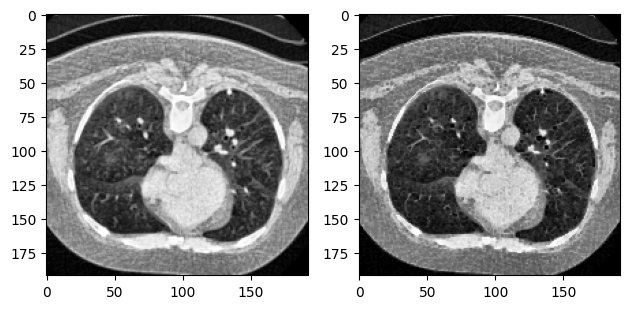

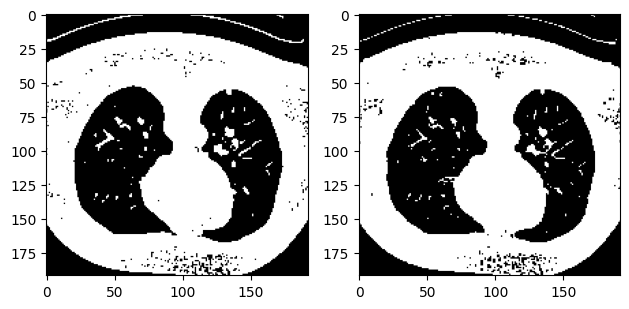

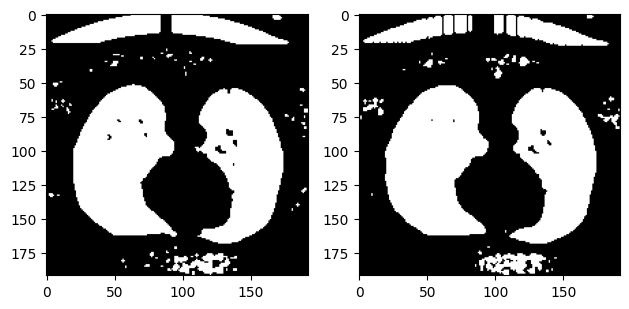

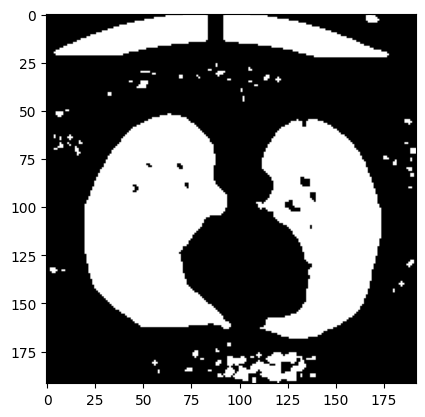

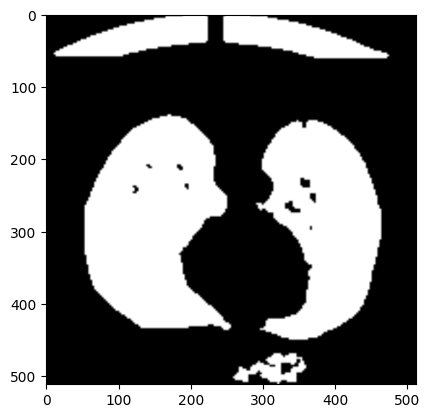

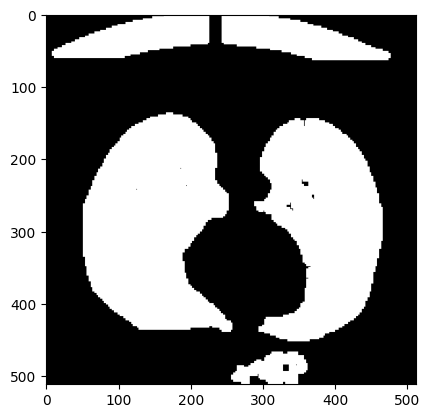

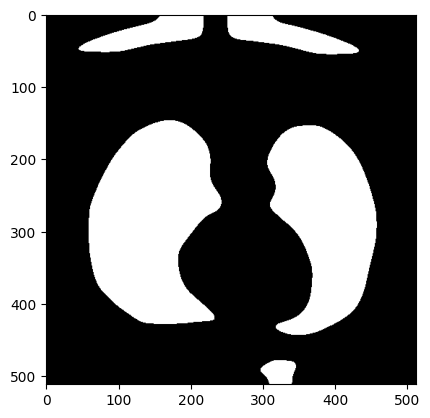

uint8


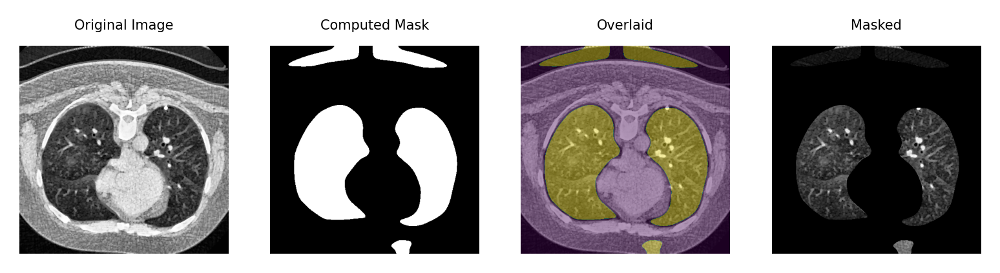

In [11]:
image = full_slices[140]
if len(image.shape) > 2: image = image[:,:,0] # Keep only one channel
mask = segment_lung_parenchyma(image, patch_size=8, expand_by=2, debug=True, min_connected=100)
print(np.multiply(mask, image).dtype)
plot_image_and_mask(image, mask)

uint8


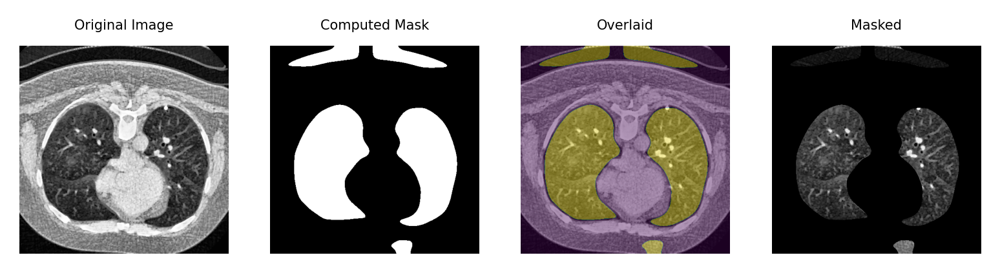

In [12]:
mask = segment_lung_parenchyma(image, patch_size=8, expand_by=2, blur_image=5, debug=False, min_connected=100)
print(np.multiply(mask, image).dtype)
plot_image_and_mask(image, mask)

In [13]:
# Labels refining 
def three_means_clustering(image, patch_size=8):
    original_shape = np.array(image.shape)
    # print(original_shape)
    image = sr.upsample(image)
    
    rows = cols = image.shape[0] // patch_size
    patches = image.reshape(rows, patch_size, -1, patch_size)
    patches = patches.swapaxes(1, 2).reshape(-1, patch_size ** 2)
    
    mean_intensity = patches.mean(axis=-1).reshape(-1, 1)
    min_intensity = patches.min(axis=-1).reshape(-1, 1)
        
    kmeans_mean = KMeans(n_clusters=3, n_init=10).fit(mean_intensity)
    kmeans_mean_intensity_map = kmeans_mean.labels_.reshape(rows, cols)
    plt.figure(dpi=200)
    plt.subplot(1, 3, 1)
    plt.axis('off')
    plt.imshow(kmeans_mean_intensity_map) 

    kmeans_min = KMeans(n_clusters=3, n_init=10).fit(min_intensity)
    kmeans_min_intensity_map = kmeans_min.labels_.reshape(rows, cols)
    plt.subplot(1, 3, 2)
    plt.axis('off')
    plt.imshow(kmeans_min_intensity_map)

    plt.subplot(1, 3, 3)
    plt.axis('off')
    plt.imshow(image)
    plt.show()
# if check_clustering(kmeans_min_intensity_map): break 

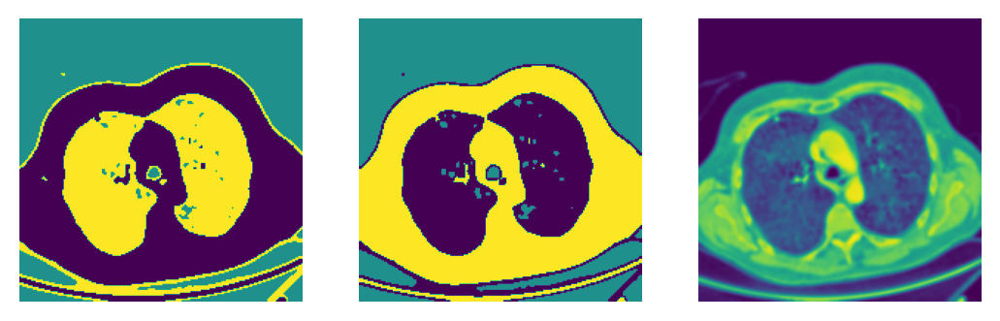

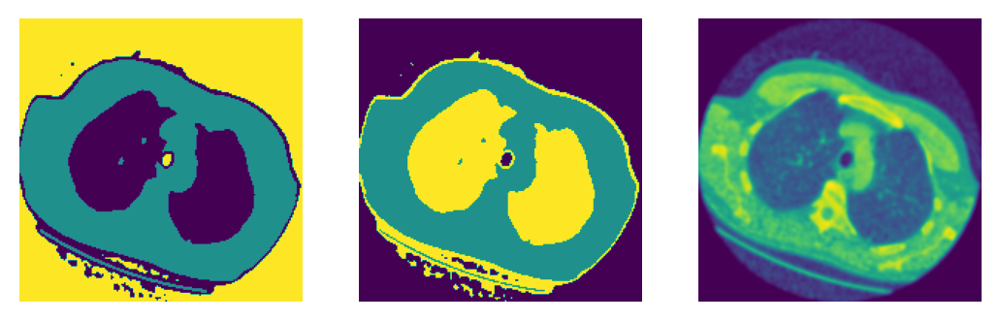

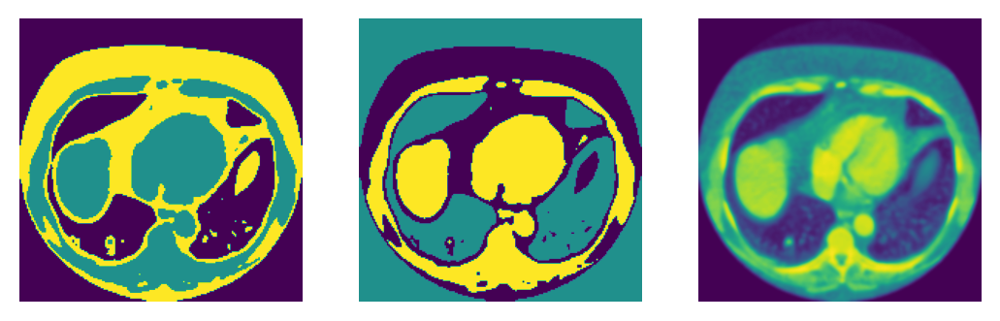

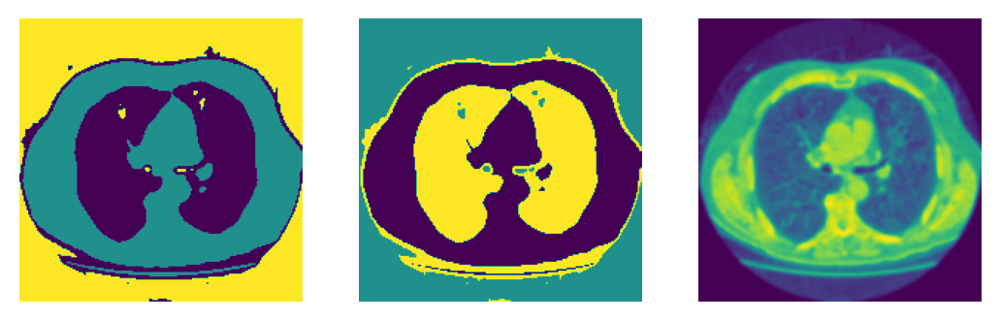

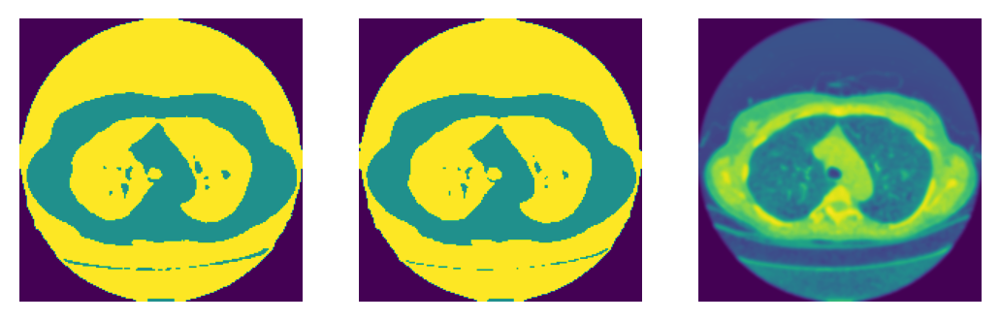

...

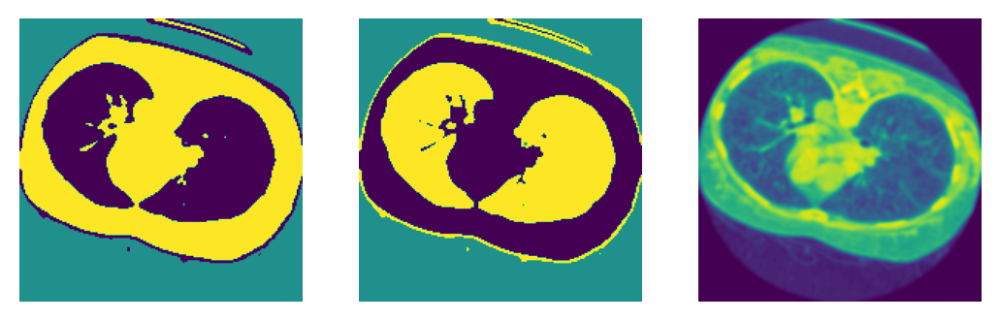

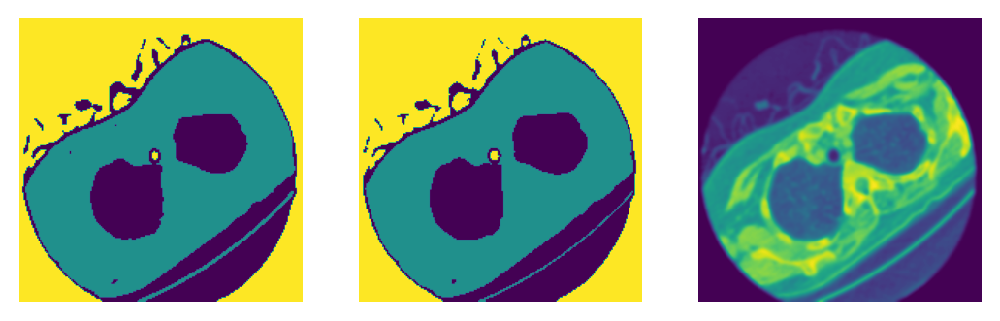

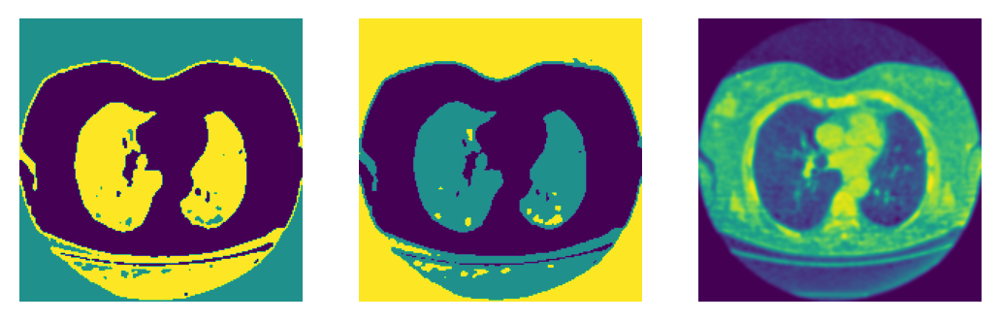

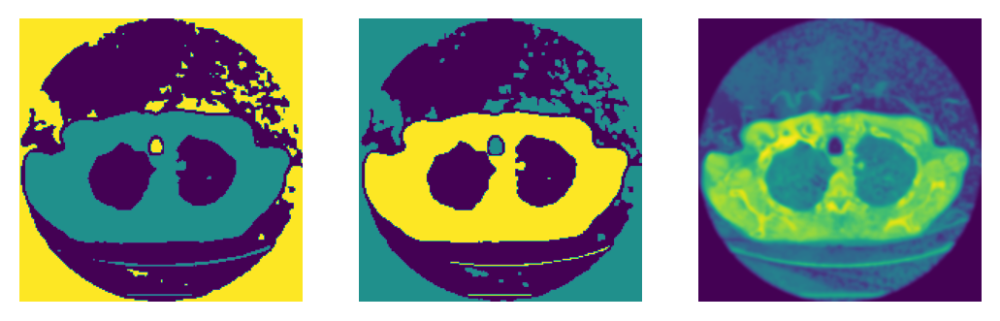

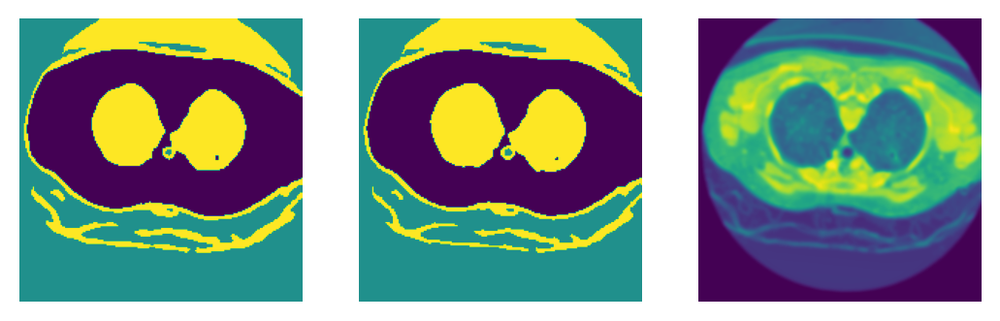

In [14]:
for idx in range(0, 200, 10):
    i = full_slices[idx]
    i = gaussian_filter(i, sigma=3)
    if len(i.shape) > 2: i = i[:,:,0] # Keep only one channel
    three_means_clustering(i, patch_size=8)

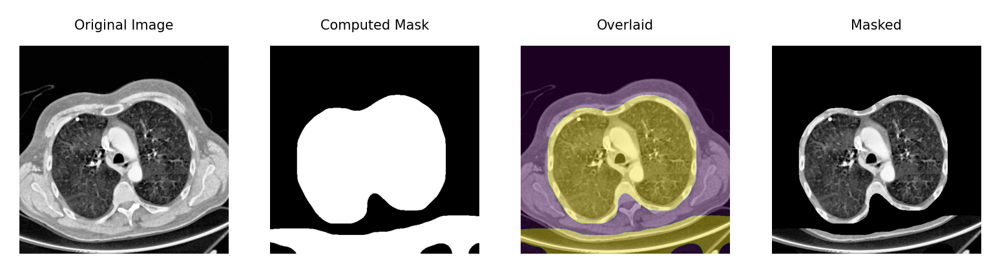

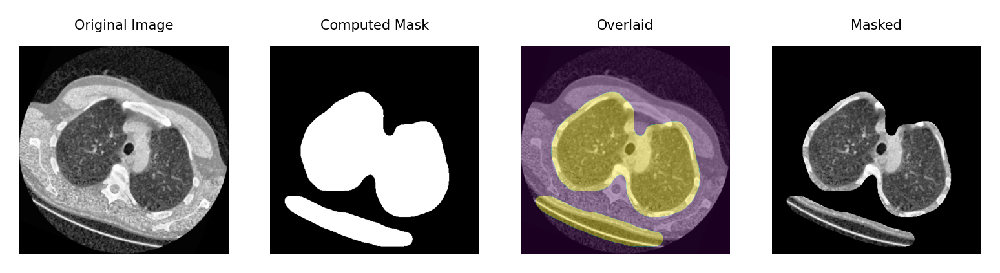

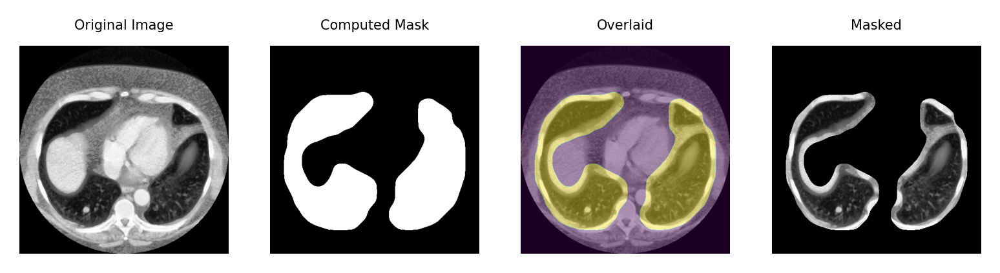

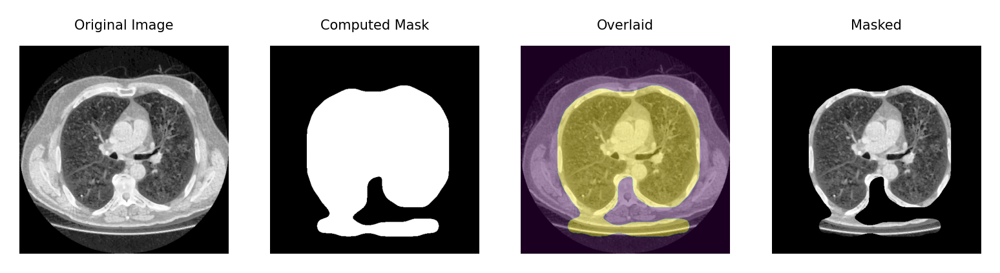

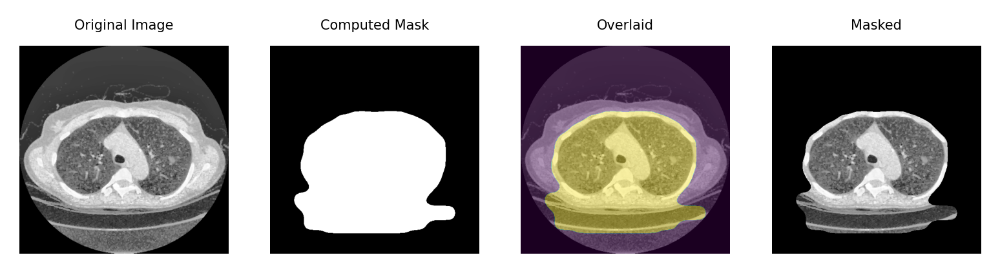

...

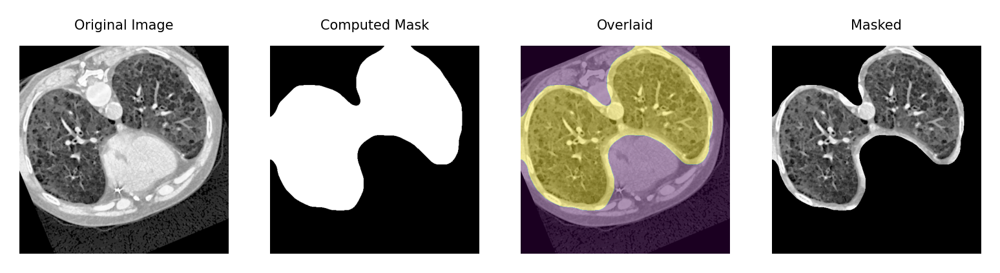

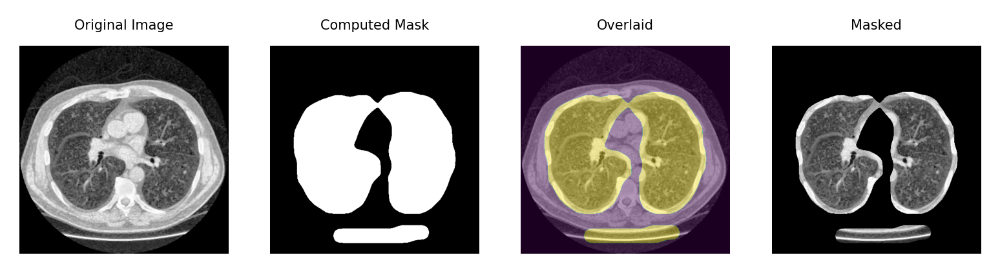

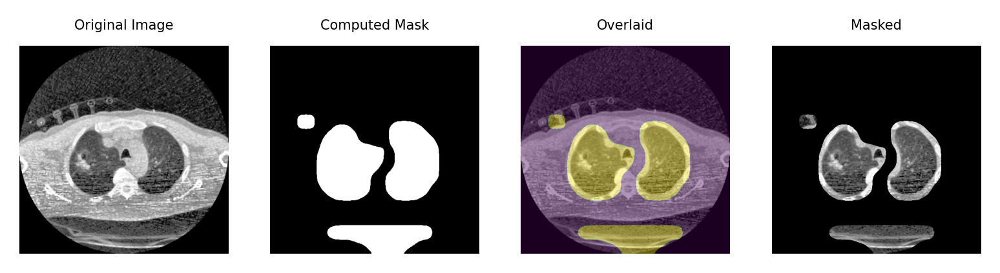

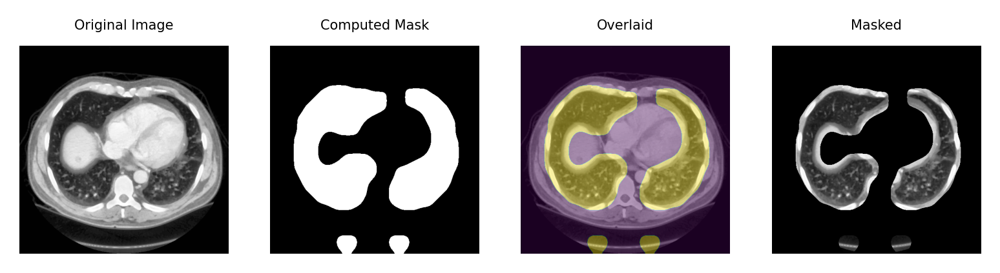

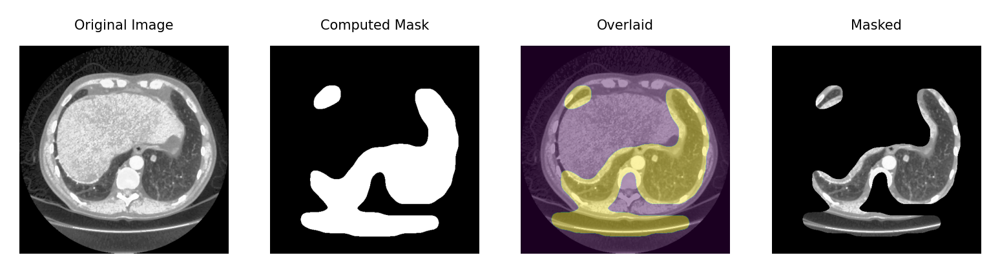

In [17]:
for i in range(0, 500, 10): 
    scan = full_slices[i]
    if len(scan.shape) > 2: scan = scan[:,:,0] # Keep only one channel
    mask = segment_lung_parenchyma(scan, patch_size=8, expand_by=20, debug=False, blur_image=5, min_connected=10)
    plot_image_and_mask(scan, mask)

In [ ]:
full_slices_squeezed = [
    x if len(x.shape) < 2 else x[:, :, 0]
    for x in tqdm(full_slices, desc="Squeezing slices")
]

masks = [
    segment_lung_parenchyma(x, patch_size=8, expand_by=20, min_connected=10)
    for x in tqdm(full_slices_squeezed, desc="Generating masks")
]
masks = np.array(masks)

segmented_lungs = [
    gray2rgb(np.multiply(image, mask)) 
    for image, mask in tqdm(zip(full_slices_squeezed, masks), desc="Segmenting lungs", total=len(full_slices_squeezed))
]
segmented_lungs = np.array(segmented_lungs)

Generating masks:   4%|▍         | 132/3089 [02:54<1:00:12,  1.22s/it]

In [ ]:
print(masks[0].shape)
print(len(masks))
print(segmented_lungs[0].shape)
print(len(segmented_lungs))

In [ ]:
# segmented_dataset = {
#     'full_slices': data['full_slices'],
#     'nodules': data['nodules'],
#     'labels': data['labels'],
#     'masks': masks,
#     'segmented_full_slices': segmented_lungs
# }

segmented_dataset = {
    'full_slices': segmented_lungs,
    'labels': data['labels']
}

In [ ]:
for key in segmented_dataset.keys():
    print(f"{key}: {segmented_dataset[key].dtype}")

In [ ]:
out_file = '/kaggle/working/segmented_only_train_set.npz'
np.savez(out_file, **segmented_dataset)

In [ ]:
data = np.load(out_file)
print(data)

In [ ]:
plt.imshow(data['full_slices'][0])
plt.show()

# plt.imshow(data['nodules'][0])
# plt.show()

# plt.imshow(data['masks'][0])
# plt.show()

# plt.imshow(data['segmented_full_slices'][0])
# plt.show()